In [37]:
import os
import pandas as pd
import folium
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
cwd = os.getcwd()
if os.path.basename(cwd) == "Notebooks":
    project_root = os.path.dirname(cwd)
else:
    project_root = cwd
path = os.path.join(project_root, "data", "Airbnb_DK_Processed_Data.csv")
df = pd.read_csv(path)

In [4]:
# plot of Airbnb listings in CPH (5000 random samples)
cph_center = [55.6761, 12.5683]
m = folium.Map(location=cph_center, zoom_start=11, tiles='cartodbpositron')
for _, row in df.sample(5000, random_state=1).iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=1,
        color="red",
        fill=True,
        fill_opacity=0.6
    ).add_to(m)
m

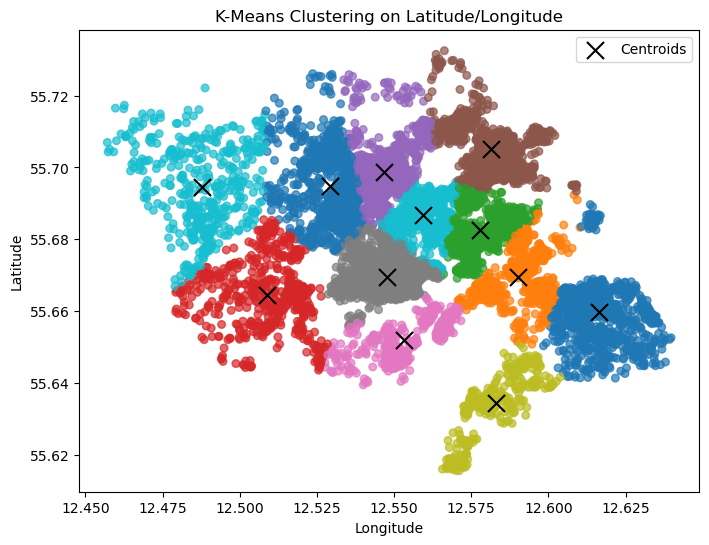

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# --- Assume df contains 'latitude' and 'longitude' columns ---

# Step 1: Extract coordinates
X = df[['longitude', 'latitude']].values

# Step 2: Choose number of clusters (you can tune this)
k = 12  # Example: 8 clusters
kmeans = KMeans(n_clusters=k, random_state=42)

# Step 3: Fit the model and get cluster labels
df['k-cluster'] = kmeans.fit_predict(X)

# Step 4: Add cluster centers
centers = kmeans.cluster_centers_

# Step 5: Plot clusters
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['k-cluster'], cmap='tab10', s=30, alpha=0.7)
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=150, marker='x', label='Centroids')
plt.title('K-Means Clustering on Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()


/var/folders/g9/wl8_th957sb253jg5r8b8t5w0000gn/T/ipykernel_12203/1933073511.py:22: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = plt.cm.get_cmap('tab10', np.max(df['db-cluster']) + 2)


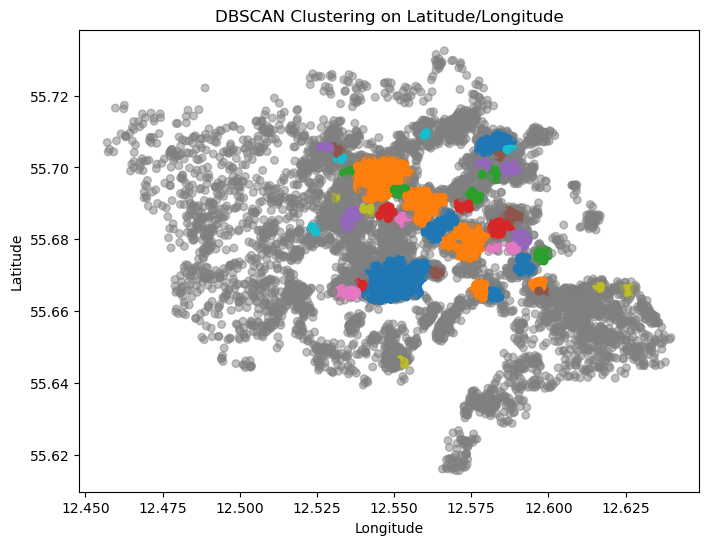

In [26]:
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# --- Assume df is already loaded and contains 'longitude' and 'latitude' columns ---

# Step 1: Extract the features
X = df[['longitude', 'latitude']].values

# Step 2: Standardize the data (important for DBSCAN performance)
X_scaled = StandardScaler().fit_transform(X)

# Step 3: Run DBSCAN
# eps controls the neighborhood radius; min_samples controls cluster density requirement
db = DBSCAN(eps=0.045, min_samples=20).fit(X_scaled)

# Step 4: Add cluster labels back to the dataframe
df['db-cluster'] = db.labels_

# Step 5: Plot the results
palette = plt.cm.get_cmap('tab10', np.max(df['db-cluster']) + 2)
colors = [palette(x) if x != -1 else (0.5, 0.5, 0.5, 0.5) for x in df['db-cluster']]
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=colors, s=30)
plt.title('DBSCAN Clustering on Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


/opt/anaconda3/lib/python3.13/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/anaconda3/lib/python3.13/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/var/folders/g9/wl8_th957sb253jg5r8b8t5w0000gn/T/ipykernel_12203/1397848393.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = plt.cm.get_cmap('tab10', np.max(df['hdb-cluster']) + 2)


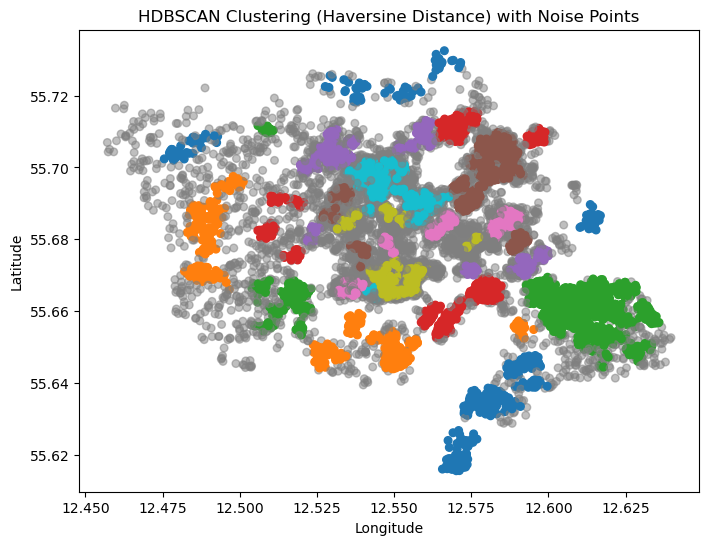

Clusters found: 81
Noise points: 3670


In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hdbscan

# --- Assume df is already loaded and contains 'latitude' and 'longitude' columns ---

# Step 1: Extract coordinates
coords = df[['latitude', 'longitude']].values

# Step 2: Convert degrees to radians (required for haversine distance)
coords_rad = np.radians(coords)

# Step 3: Run HDBSCAN with Haversine metric
# min_cluster_size = minimum number of points per cluster
clusterer = hdbscan.HDBSCAN(min_cluster_size=12, metric='haversine')
cluster_labels = clusterer.fit_predict(coords_rad)

# Step 4: Add cluster labels to DataFrame
df['hdb-cluster'] = cluster_labels

# Step 5: Plot results
palette = plt.cm.get_cmap('tab10', np.max(df['hdb-cluster']) + 2)
colors = [palette(x) if x != -1 else (0.5, 0.5, 0.5, 0.5) for x in df['hdb-cluster']]
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=colors, s=30)
plt.title('HDBSCAN Clustering (Haversine Distance) with Noise Points')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

# Step 6: Print summary
num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
num_noise = list(cluster_labels).count(-1)
print(f"Clusters found: {num_clusters}")
print(f"Noise points: {num_noise}")


In [28]:
import folium
import matplotlib.pyplot as plt
import numpy as np

# --- Assume df already contains: latitude, longitude, cluster ---

# Step 1: Create a base map centered around the data
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Step 2: Define color palette
# Get unique cluster labels
clusters = sorted(df['hdb-cluster'].unique())

# Create a colormap using matplotlib (tab10 or any other)
cmap = plt.cm.get_cmap('tab10', len(clusters))
colors = {cluster: f'rgba({int(r*255)}, {int(g*255)}, {int(b*255)}, 0.8)'
          for cluster, (r, g, b, _) in zip(clusters, cmap(range(len(clusters))))}

# Step 3: Assign a neutral grey color to noise points (-1)
colors[-1] = 'rgba(150,150,150,0.5)'  # semi-transparent grey

# Step 4: Plot each point as a colored CircleMarker
for _, row in df.iterrows():
    cluster = row['hdb-cluster']
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color=colors[cluster],
        fill=True,
        fill_color=colors[cluster],
        fill_opacity=0.3,
        opacity=0.5,
        popup=f'Cluster: {cluster}'
    ).add_to(m)

# Step 5: Display the map
m


/var/folders/g9/wl8_th957sb253jg5r8b8t5w0000gn/T/ipykernel_12203/707500893.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', len(clusters))


In [12]:
# Convert price column to float
df['price'] = (
    df['price']
    .astype(str)
    .str.replace('[^\d.]', '', regex=True)  # fjerner alt der ikke er tal eller punktum
    .astype(float)
)

In [43]:
# Statistics on the clusters
cluster_means = df.groupby('k-cluster')['price'].mean().round(1)
print(cluster_means)

k-cluster
0     1106.7
1     1254.2
2     1587.7
3     2096.2
4     1101.1
5     1128.8
6     1420.3
7     1419.1
8     1411.4
9     1305.4
10    1004.8
11    1597.7
Name: price, dtype: float64


In [39]:
# Sentiment analysis of comments
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk
nltk.download('vader_lexicon')

sia = SentimentIntensityAnalyzer()

df = df.copy()
df['sentiment'] = df['comments'].astype(str).apply(lambda x: sia.polarity_scores(x)['compound'])

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/fridafrandsen/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


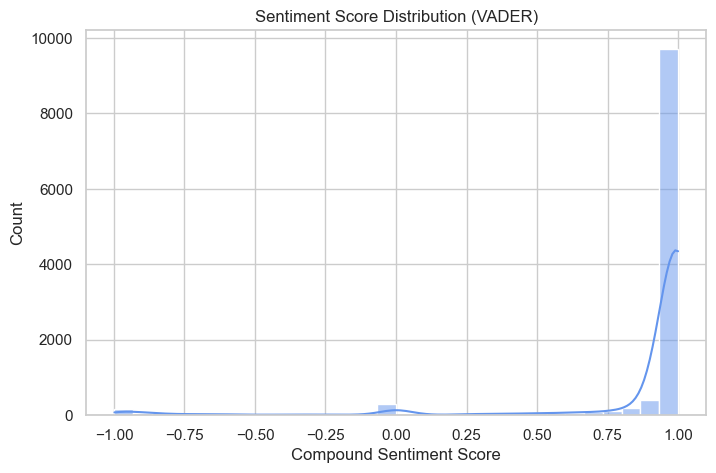

In [40]:
# Distribution of sentiments (1 is very positive, -1 very negative)
sns.set(style="whitegrid")
plt.figure(figsize=(8,5))
sns.histplot(df['sentiment'], bins=30, kde=True, color='cornflowerblue')
plt.title('Sentiment Score Distribution (VADER)')
plt.xlabel('Compound Sentiment Score')
plt.ylabel('Count')
plt.show()

In [44]:
cluster_summary = df.groupby('k-cluster').agg({
    'price': 'mean',
    'sentiment': 'mean',
    'id': 'count'
}).round(2)

print(cluster_summary)

             price  sentiment    id
k-cluster                          
0          1106.74       0.84  1104
1          1254.20       0.86   987
2          1587.75       0.89   930
3          2096.16       0.95  1151
4          1101.09       0.82   571
5          1128.83       0.87  1498
6          1420.32       0.87  1151
7          1419.11       0.81   455
8          1411.36       0.89  1892
9          1305.35       0.88   311
10         1004.76       0.76   432
11         1597.68       0.92  1099


In [46]:
# Map of clusters

# Step 1: Create a base map centered around the data
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Step 2: Define color palette
# Get unique cluster labels
clusters = sorted(df['k-cluster'].unique())

# Create a colormap using matplotlib (tab10 or any other)
cmap = plt.cm.get_cmap('tab10', len(clusters))
colors = {cluster: f'rgba({int(r*255)}, {int(g*255)}, {int(b*255)}, 0.8)'
          for cluster, (r, g, b, _) in zip(clusters, cmap(range(len(clusters))))}

# Step 3: Assign a neutral grey color to noise points (-1)
colors[-1] = 'rgba(150,150,150,0.5)'  # semi-transparent grey

# Step 4: Plot each point as a colored CircleMarker
for _, row in df.iterrows():
    cluster = row['k-cluster']
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color=colors[cluster],
        fill=True,
        fill_color=colors[cluster],
        fill_opacity=0.3,
        opacity=0.5,
        popup=f'Cluster: {cluster}'
    ).add_to(m)

for cl, row in cluster_summary.iterrows():
    subset = df[df['k-cluster'] == cl]
    folium.Marker(
        location=[
            subset['latitude'].mean(),
            subset['longitude'].mean()
        ],
        popup=(
            f"Cluster {cl}<br>"
            f"Average price: {row['price']:.0f} DKK<br>"
            f"Average sentiment: {row['sentiment']:.2f}<br>"
            f"Listings: {int(row['id'])}"
        )
    ).add_to(m)

# Step 5: Display the map
m

/var/folders/g9/wl8_th957sb253jg5r8b8t5w0000gn/T/ipykernel_12203/1810737909.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', len(clusters))
